In [3]:
print('hello')

hello


print('OK')
print('NG')

これは？

In [11]:
print('OKKK')

OKKK


In [2]:
print('OKK')

OKK


In [7]:
from requests_oauthlib import OAuth1Session
from requests.exceptions import ConnectionError, ReadTimeout, SSLError
import json, datetime, time, pytz, re, sys,traceback, pymongo
#from pymongo import Connection     # Connection classは廃止されたのでMongoClientに変更 
from pymongo import MongoClient
from collections import defaultdict
import numpy as np

KEYS = { # 自分のアカウントで入手したキーを下記に記載
        'consumer_key':'OXVAEeVvhbayWBx9eAlbTP8rg',
        'consumer_secret':'JbrmXQL85rfDkKH91hZZXPSEUKYYwqdIjBSV0qqM0lxlu6Iddq',
        'access_token':'781756558300426240-SH333lX0Xjq8mMCUbtHiQylA1MZCZcg',
        'access_secret':'OsAc9AjgoMBtsPgwST0kkaJKl7DTyKwmnLzbUkPhS9Xgf',
       }

twitter = None
connect = None
db      = None
tweetdata = None
meta    = None

def initialize(): # twitter接続情報や、mongoDBへの接続処理等initial処理実行
    global twitter, twitter, connect, db, tweetdata, meta
    twitter = OAuth1Session(KEYS['consumer_key'],KEYS['consumer_secret'],
                            KEYS['access_token'],KEYS['access_secret'])
#   connect = Connection('localhost', 27017)     # Connection classは廃止されたのでMongoClientに変更 
    connect = MongoClient('localhost', 27017)
    db = connect.starbucks
    tweetdata = db.tweetdata
    meta = db.metadata

initialize()

In [13]:
# 検索ワードを指定して100件のTweetデータをTwitter REST APIsから取得する
def getTweetData(search_word, max_id, since_id):
    global twitter
    url = 'https://api.twitter.com/1.1/search/tweets.json'
    params = {'q': search_word,
              'count':'100',
    }
    # max_idの指定があれば設定する
    if max_id != -1:
        params['max_id'] = max_id
    # since_idの指定があれば設定する
    if since_id != -1:
        params['since_id'] = since_id

    req = twitter.get(url, params = params)   # Tweetデータの取得

    # 取得したデータの分解
    if req.status_code == 200: # 成功した場合
        timeline = json.loads(req.text)
        metadata = timeline['search_metadata']
        statuses = timeline['statuses']
        limit = req.headers['x-rate-limit-remaining'] if 'x-rate-limit-remaining' in req.headers else 0
        reset = req.headers['x-rate-limit-reset'] if 'x-rate-limit-reset' in req.headers else 0              
        return {"result":True, "metadata":metadata, "statuses":statuses, "limit":limit, "reset_time":datetime.datetime.fromtimestamp(float(reset)), "reset_time_unix":reset}
    else: # 失敗した場合
        print ("Error: %d" % req.status_code)
        return{"result":False, "status_code":req.status_code}

# 文字列を日本時間2タイムゾーンを合わせた日付型で返す
def str_to_date_jp(str_date):
    dts = datetime.datetime.strptime(str_date,'%a %b %d %H:%M:%S +0000 %Y')
    return pytz.utc.localize(dts).astimezone(pytz.timezone('Asia/Tokyo'))

# 現在時刻をUNIX Timeで返す
def now_unix_time():
    return time.mktime(datetime.datetime.now().timetuple())

In [16]:
sid=-1
mid = -1 
count = 0

res = None
while(True):    
    try:
        count = count + 1
        sys.stdout.write("%d, "% count)
        res = getTweetData(u'スタバ', max_id=mid, since_id=sid)
        if res['result']==False:
            # 失敗したら終了する
            print("status_code", res['status_code'])
            break

        if int(res['limit']) == 0:    # 回数制限に達したので休憩
            # 日付型の列'created_datetime'を付加する
            print("Adding created_at field.")
            for d in tweetdata.find({'created_datetime':{ "$exists": False }},{'_id':1, 'created_at':1}):
                #print str_to_date_jp(d['created_at'])
                tweetdata.update({'_id' : d['_id']}, 
                     {'$set' : {'created_datetime' : str_to_date_jp(d['created_at'])}})
            #remove_duplicates()

            # 待ち時間の計算. リミット＋５秒後に再開する
            diff_sec = int(res['reset_time_unix']) - now_unix_time()
            print("sleep %d sec." % (diff_sec+5))
            if diff_sec > 0:
                time.sleep(diff_sec + 5)
        else:
            # metadata処理
            if len(res['statuses'])==0:
                sys.stdout.write("statuses is none. ")
            elif 'next_results' in res['metadata']:
                # 結果をmongoDBに格納する
                meta.insert({"metadata":res['metadata'], "insert_date": now_unix_time()})
                for s in res['statuses']:
                    tweetdata.insert(s)
                next_url = res['metadata']['next_results']
                pattern = r".*max_id=([0-9]*)\&.*"
                ite = re.finditer(pattern, next_url)
                for i in ite:
                    mid = i.group(1)
                    break
            else:
                sys.stdout.write("next is none. finished.")
                break
   
    finally:
        info = sys.exc_info()



1, 

/home/kei/.pyenv/versions/3.5.2/lib/python3.5/site-packages/ipykernel/__main__.py:36: DeprecationWarning: insert is deprecated. Use insert_one or insert_many instead.
/home/kei/.pyenv/versions/3.5.2/lib/python3.5/site-packages/ipykernel/__main__.py:38: DeprecationWarning: insert is deprecated. Use insert_one or insert_many instead.


2, 3, 4, 5, 6, 7, 8, 

KeyboardInterrupt: 

In [19]:
print("OK")


OK


In [2]:
def edit_story(words, func):
    for word in words:
        print(func(word))
stairs = ['thud', 'meow', 'thud', 'hiss']

In [3]:
def enliven(word):
    return word.capitalize() + '!'

In [6]:
edit_story(stairs, enliven)

Thud!
Meow!
Thud!
Hiss!


In [7]:
edit_story(stairs, lambda word: word.capitalize() + '!')

Thud!
Meow!
Thud!
Hiss!


In [8]:
def my_range(first=0, last=10, step=1):
    number = first
    while number < last:
        yield number
        number += step
        

In [9]:
my_range


<function __main__.my_range>

In [12]:
ranger = my_range(1, 5)
ranger

<generator object my_range at 0x7f72746a0990>

In [13]:
for x in ranger:
    print(x)

1
2
3
4


In [14]:
@document_it
def add_ints(a,b):
    return a+b


NameError: name 'document_it' is not defined

In [15]:
def document_it(func):
    def new_function(*args, **kwargs):
        print('Running function: ', func.__name__)
        print('Positional arguments: ', args)
        print('Keyword arguments: ', kwargs)
        result = func(*args, **kwargs)
        print('Result: ', result)
        return result
    return new_function

In [16]:
def add_ints(a,b):
    return a+b

In [17]:
add_ints(3,5)

8

In [18]:
@document_it
def add_ints2(a,b):
    return a+b


In [19]:
add_ints2(4,8)

Running function:  add_ints2
Positional arguments:  (4, 8)
Keyword arguments:  {}
Result:  12


12

In [20]:
id(add_ints2)

140129555603936

In [21]:
print(globals())

{'_i10': 'ranger = my_range(1, 101)\nranger', '_i8': 'def my_range(first=0, last=10, step=1):\n    number = first\n    while number < last:\n        yield number\n        number += step\n        ', '__builtins__': <module 'builtins' (built-in)>, '_ih': ['', "def edit_story(words, func);\n    for word in words:\n        print(func(word))\nstairs = ['thud', 'meow', 'thud', 'hiss']", "def edit_story(words, func):\n    for word in words:\n        print(func(word))\nstairs = ['thud', 'meow', 'thud', 'hiss']", "def enliven(word):\n    return word.capitalize() + '!'", 'edit_story(stairs, enliven)', 'edit_story(stairs, enliven)', 'edit_story(stairs, enliven)', "edit_story(stairs, lambda word: word.capitalize() + '!')", 'def my_range(first=0, last=10, step=1):\n    number = first\n    while number < last:\n        yield number\n        number += step\n        ', 'my_range', 'ranger = my_range(1, 101)\nranger', 'for x in ranger:\n    print(x)', 'ranger = my_range(1, 5)\nranger', 'for x in ranger

In [22]:
import math

In [23]:
math.pi

3.141592653589793

In [24]:
math.e

2.718281828459045

In [25]:
import sys

In [26]:
for place in sys.path:
    print(place)


/home/kei/.pyenv/versions/3.5.2/lib/python35.zip
/home/kei/.pyenv/versions/3.5.2/lib/python3.5
/home/kei/.pyenv/versions/3.5.2/lib/python3.5/plat-linux
/home/kei/.pyenv/versions/3.5.2/lib/python3.5/lib-dynload
/home/kei/.pyenv/versions/3.5.2/lib/python3.5/site-packages
/home/kei/.pyenv/versions/3.5.2/lib/python3.5/site-packages/IPython/extensions
/home/kei/.ipython


In [27]:
from collections import namedtuple
Person = namedtuple('Person', 'name tall sex')
person_a = Person('Kei', 175, 'male')
person_a

Person(name='Kei', tall=175, sex='male')

In [28]:
person_a.name

'Kei'

In [29]:
person_a.tall

175

In [30]:
person_b = Person('ABC', 160, 'female')

In [31]:
person_b

Person(name='ABC', tall=160, sex='female')

In [33]:
person_a.tall + person_b.tall

335

In [34]:
import numpy as np

In [35]:
x = np.array([1.0, 2.0, 3.0])
print(x)

[ 1.  2.  3.]


In [36]:
type(x)

numpy.ndarray

In [37]:
y = np.array([2.0, 4.0, 6.0])
x +y

array([ 3.,  6.,  9.])

In [38]:
x*y

array([  2.,   8.,  18.])

In [39]:
x/y

array([ 0.5,  0.5,  0.5])

In [40]:
x/2

array([ 0.5,  1. ,  1.5])

In [41]:
print(x)

[ 1.  2.  3.]


In [42]:
x>1.5


array([False,  True,  True], dtype=bool)

In [43]:
print(x[x>1.5])

[ 2.  3.]


In [44]:
import matplotlib.pyplot as plt

/home/kei/.pyenv/versions/3.5.2/lib/python3.5/site-packages/matplotlib/font_manager.py:273: UserWarning: Matplotlib is building the font cache using fc-list. This may take a moment.
  warnings.warn('Matplotlib is building the font cache using fc-list. This may take a moment.')
/home/kei/.pyenv/versions/3.5.2/lib/python3.5/site-packages/matplotlib/font_manager.py:273: UserWarning: Matplotlib is building the font cache using fc-list. This may take a moment.
  warnings.warn('Matplotlib is building the font cache using fc-list. This may take a moment.')


In [46]:
x = np.arange(0,6,0.1)
y = np.sin(x)

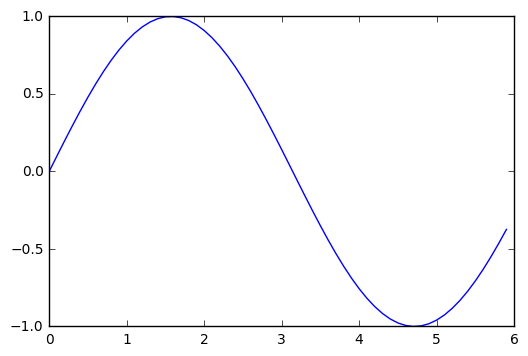

In [47]:
plt.plot(x, y)
plt.show()

In [48]:
import matplotlib.pyplot as plt

In [49]:
print(x)

[ 0.   0.1  0.2  0.3  0.4  0.5  0.6  0.7  0.8  0.9  1.   1.1  1.2  1.3  1.4
  1.5  1.6  1.7  1.8  1.9  2.   2.1  2.2  2.3  2.4  2.5  2.6  2.7  2.8  2.9
  3.   3.1  3.2  3.3  3.4  3.5  3.6  3.7  3.8  3.9  4.   4.1  4.2  4.3  4.4
  4.5  4.6  4.7  4.8  4.9  5.   5.1  5.2  5.3  5.4  5.5  5.6  5.7  5.8  5.9]


In [50]:
y1 = np.sin(x)
y2 = np.cos(x)

In [51]:
plt.plot(x, y1, label="sin")
plt.plot(x, y2, linestyle="--", label="cos")
plt.xlabel("x")
plt.ylabel("y")
plt.title(' sin & cos ')


In [52]:
plt.legend()

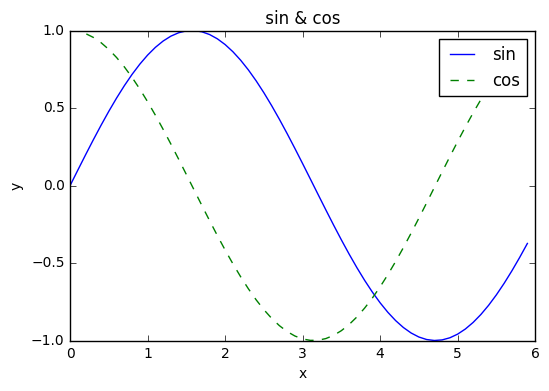

In [53]:
plt.show()

In [54]:
from matplotlib.image import imread


In [56]:
img = imread('sakura.png')

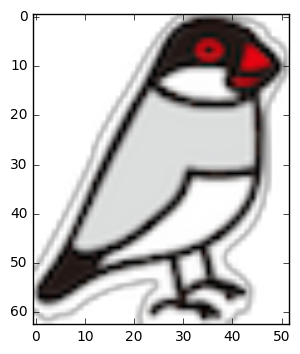

In [57]:
plt.imshow(img)
plt.show()

In [58]:
def AND(x1, x2):
    w1, w2, theta = 0.5, 0.5, 0.7
    tmp = x1*w1 + x2*w2
    if tmp <= theta:
        return 0
    else:
        return 1

In [59]:
AND(0,1)

0

In [60]:
AND(1,1)

1

In [61]:
AND(2,0)

1

In [62]:
AND(1,0)

0

In [63]:
x = np.array([0,1])
w = np.array([0.5, 0.5])

In [64]:
b = -0.7

In [65]:
w*x


array([ 0. ,  0.5])

In [66]:
np.sum(w*x)

0.5

In [67]:
np.sum(w*x) + b

-0.19999999999999996

In [68]:
def AND(x1, x2):
    x = np.array([x1, x2])
    w = np.array([0.5, 0.5])
    b = -0.7
    tmp = np.sum(x*w) + b
    if tmp <= 0:
        return 0
    else:
        return 1

In [69]:
AND(1,1)

1

In [70]:
AND(1,0)

0

In [71]:
AND(0,0)

0

In [72]:
AND(0,1)

0

In [73]:
def NAND(x1, x2):
    x = np.array([x1, x2])
    w = np.array([-0.5, -0.5])
    b = 0.7
    tmp = np.sum(x*w) + b
    if tmp <= 0:
        return 0
    else:
        return 1

In [74]:
NAND(1,1)

0

In [75]:
NAND(1,0)

1

In [76]:
NAND(0,0)

1

In [77]:
def OR(x1, x2):
    x = np.array([x1, x2])
    w = np.array([0.5, 0.5])
    b = -0.2
    tmp = np.sum(x*w) + b
    if tmp <= 0:
        return 0
    else:
        return 1

In [78]:
OR(1,0)

1

In [79]:
OR(0,0)

0

In [80]:
OR(1,1)

1

In [81]:
OR(0,1)

1

In [82]:
def XOR(x1, x2):
    s1 = NAND(x1, x2)
    s2 = OR(x1, x2)
    y = AND(s1, s2)
    return y

In [83]:
XOR(1,1)

0

In [84]:
XOR(1,0)

1

In [85]:
XOR(0,1)

1

In [86]:
XOR(0,0)

0

In [89]:
x = np.arange(0,6,0.1)
y = 1 / (1 + math.e(-x))

TypeError: 'float' object is not callable

In [90]:
import math

In [93]:
x = np.arange(0,6,0.1)

In [96]:
y = 1 / (1 + math.e**(-x))

In [97]:
plt.plot(x,y)

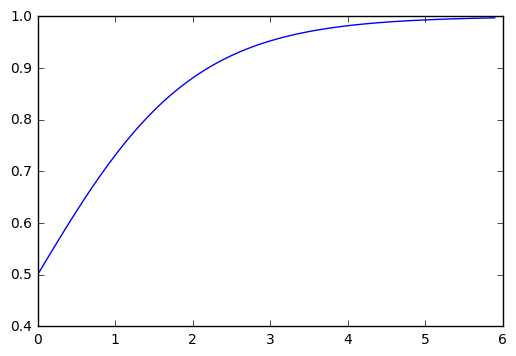

In [98]:
plt.show()

In [99]:
x = np.arange(-6,6,0.1)

In [100]:
plt.show()

In [101]:
plt.plot(x,y)

ValueError: x and y must have same first dimension

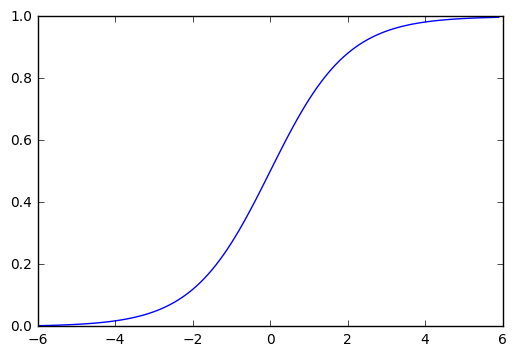

In [102]:
x = np.arange(-6,6,0.1)
y = 1 / (1 + math.e**(-x))
plt.plot(x,y)
plt.show()

In [103]:
x = np.array([-1.0, 1.0, 2.0])
x

array([-1.,  1.,  2.])

In [104]:
y = x>0

In [105]:
y

array([False,  True,  True], dtype=bool)

In [106]:
y = y.astype(np.int)
y

array([0, 1, 1])

In [107]:
x = np.arange(-5.0, 5.0, 0.1)
y = x>0
y

array([False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,  True], dtype=bool)

In [108]:
y = y.astype(np.int)

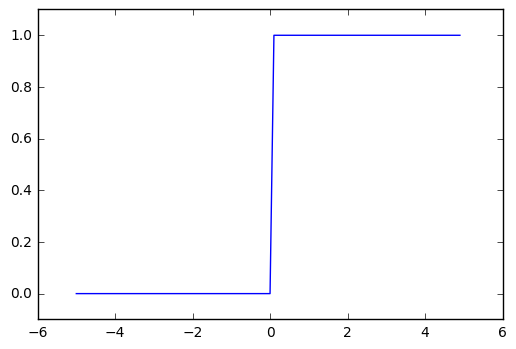

In [109]:
plt.plot(x,y)
plt.ylim(-0.1, 1.1)
plt.show()

In [110]:
def sigmoid(x):
    return 1 / (1 + np.exp(-x))

In [111]:
x = np.arange(-5.0, 5.0, 0.1)
y = sigmoid(x)


In [112]:
y

array([ 0.00669285,  0.00739154,  0.00816257,  0.0090133 ,  0.0099518 ,
        0.01098694,  0.01212843,  0.01338692,  0.01477403,  0.0163025 ,
        0.01798621,  0.01984031,  0.02188127,  0.02412702,  0.02659699,
        0.02931223,  0.03229546,  0.03557119,  0.03916572,  0.04310725,
        0.04742587,  0.05215356,  0.05732418,  0.06297336,  0.06913842,
        0.07585818,  0.0831727 ,  0.09112296,  0.09975049,  0.10909682,
        0.11920292,  0.13010847,  0.14185106,  0.15446527,  0.16798161,
        0.18242552,  0.19781611,  0.21416502,  0.23147522,  0.24973989,
        0.26894142,  0.2890505 ,  0.31002552,  0.33181223,  0.35434369,
        0.37754067,  0.40131234,  0.42555748,  0.450166  ,  0.47502081,
        0.5       ,  0.52497919,  0.549834  ,  0.57444252,  0.59868766,
        0.62245933,  0.64565631,  0.66818777,  0.68997448,  0.7109495 ,
        0.73105858,  0.75026011,  0.76852478,  0.78583498,  0.80218389,
        0.81757448,  0.83201839,  0.84553473,  0.85814894,  0.86

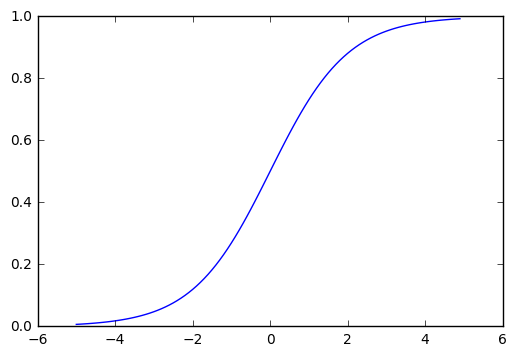

In [113]:
plt.plot(x,y)
plt.show()

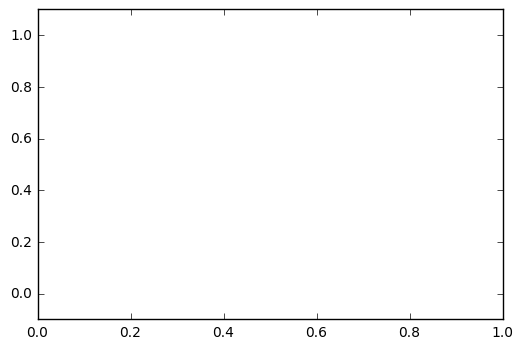

In [114]:
plt.ylim(-0.1, 1.1)
plt.show()

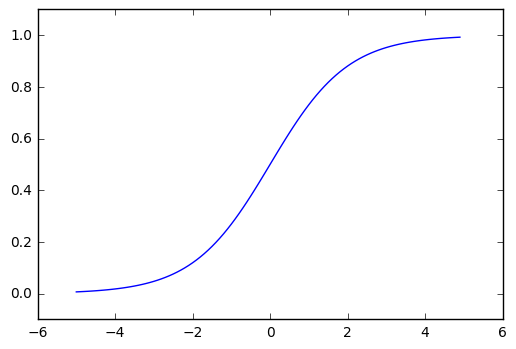

In [115]:
plt.plot(x,y)
plt.ylim(-0.1, 1.1)
plt.show()

In [116]:
B = np.array([1,2], [3,4], [5,6])

ValueError: only 2 non-keyword arguments accepted

In [117]:
B = np.array([[1,2], [3,4], [5,6]])

In [118]:
B

array([[1, 2],
       [3, 4],
       [5, 6]])

In [119]:
B.shape()

TypeError: 'tuple' object is not callable

In [120]:
B.shape

(3, 2)

In [121]:
np.ndim(B)

2

In [122]:
A = np.array([[1,2],[3,4]])

In [123]:
B = np.array([[5,6],[7,8]])

In [124]:
A.shape

(2, 2)

In [125]:
B.shape

(2, 2)

In [126]:
np.dot(A,B)

array([[19, 22],
       [43, 50]])

In [127]:
X = np.array([1,0.5])
W1 = np.array([[0.1,0.3,0.5],[0.2,0.4,0.6]])
B1 = np.array([0.1,0.2,0.3])

In [128]:
W1.shape

(2, 3)

In [129]:
X.shape

(2,)

In [130]:
B1.shape

(3,)

In [131]:
A1 = dot(X,W1) + B1

NameError: name 'dot' is not defined

In [132]:
A1 = np.dot(X,W1)+B1

In [133]:
A1

array([ 0.3,  0.7,  1.1])

In [134]:
Z1 = sigmoid(A1)

In [135]:
Z1

array([ 0.57444252,  0.66818777,  0.75026011])

In [137]:
W2 = np.array([[0.1,0.4],[0.2,0.5],[0.3,0.6]])
B2 = np.array([0.1,0.2])

Z1

In [138]:
A1

array([ 0.3,  0.7,  1.1])

In [139]:
Z1 = sigmoid(A1)

In [140]:
Z1


array([ 0.57444252,  0.66818777,  0.75026011])

In [141]:
Z1.shape


(3,)

In [142]:
B2.shape

(2,)

In [143]:
W2.shape

(3, 2)

In [144]:
A2 = np.dot(Z1, W2) + B2


In [145]:
A2

array([ 0.51615984,  1.21402696])

In [146]:
Z2 = sigmoid(A2)

In [147]:
Z2

array([ 0.62624937,  0.7710107 ])

In [152]:
W3 = np.array([[0.1,0.3],
              [0.2,0.4]])

In [153]:
B3 = np.array([0.1,0.2])

In [154]:
A3 = np.dot(Z2,W3) + B3

In [155]:
A3

array([ 0.31682708,  0.69627909])

In [156]:
def init_network():
        network = {}
        network['W1'] = np.array([[0.1, 0.3, 0.5], [0.2, 0.4, 0.6]])
        network['b1'] = np.array([0.1, 0.2, 0.3])
        network['W2'] = np.array([[0.1, 0.4], [0.2, 0.5], [0.3, 0.6]])
        network['b2'] = np.array([0.1, 0.2])
        network['W3'] = np.array([[0.1, 0.3], [0.2, 0.4]])
        network['b3'] = np.array([0.1, 0.2])
        return network

In [157]:
network = init_network()


In [158]:
network['W1']

array([[ 0.1,  0.3,  0.5],
       [ 0.2,  0.4,  0.6]])

In [159]:
network

{'W1': array([[ 0.1,  0.3,  0.5],
        [ 0.2,  0.4,  0.6]]), 'W2': array([[ 0.1,  0.4],
        [ 0.2,  0.5],
        [ 0.3,  0.6]]), 'W3': array([[ 0.1,  0.3],
        [ 0.2,  0.4]]), 'b1': array([ 0.1,  0.2,  0.3]), 'b2': array([ 0.1,  0.2]), 'b3': array([ 0.1,  0.2])}

In [160]:
a = np.array([0.3,2.9,4.0])

In [161]:
exp_a = np.exp(a)

In [162]:
exp_a

array([  1.34985881,  18.17414537,  54.59815003])

In [163]:
sum_exp_a = np.sum(exp_a)

In [164]:
sum_exp_a

74.122154210163302

In [165]:
y = exp_a / sum_exp_a
y

array([ 0.01821127,  0.24519181,  0.73659691])

In [166]:
def softmax(a):
    exp_a = np.exp(a)
    sum_exp_a = np.sum(exp_a)
    y = exp_a / sum_exp_a
    
    return y

In [167]:
softmax(a)

array([ 0.01821127,  0.24519181,  0.73659691])

In [168]:
a = np.array([1010, 1000, 990])

In [169]:
np.exp(a)

/home/kei/.pyenv/versions/3.5.2/lib/python3.5/site-packages/ipykernel/__main__.py:1: RuntimeWarning: overflow encountered in exp
  if __name__ == '__main__':


array([ inf,  inf,  inf])

In [170]:
np.exp(a) / np.sum(np.exp(a))

/home/kei/.pyenv/versions/3.5.2/lib/python3.5/site-packages/ipykernel/__main__.py:1: RuntimeWarning: overflow encountered in exp
  if __name__ == '__main__':
/home/kei/.pyenv/versions/3.5.2/lib/python3.5/site-packages/ipykernel/__main__.py:1: RuntimeWarning: invalid value encountered in true_divide
  if __name__ == '__main__':


array([ nan,  nan,  nan])

In [171]:
c = np.map(a)

AttributeError: module 'numpy' has no attribute 'map'

In [172]:
c = np.max(a)

In [173]:
c


1010

In [174]:
a - c


array([  0, -10, -20])

In [175]:
np.exp(a-c) / np.sum(np.exp(a-c))

array([  9.99954600e-01,   4.53978686e-05,   2.06106005e-09])

In [176]:
def softmax(a):
    c = np.max(a)
    exp_a = np.exp(a-c)
    sum_exp_a = np.sum(exp_a)
    y = exp_a / sum_exp_a
    
    return y

In [177]:
a = np.array([0.3,2.9,4.0])
softmax(a)

array([ 0.01821127,  0.24519181,  0.73659691])

In [178]:
np.sum(softmax(a))

1.0

In [179]:
import sys, os

In [180]:
from deep-learning-from-scratch-master.dataset.mnist import load_mnist

SyntaxError: invalid syntax (<ipython-input-180-682f910f3ad2>, line 1)

In [181]:
sys.path.append(os.pardir)

In [182]:
sys.path

['',
 '/home/kei/.pyenv/versions/3.5.2/lib/python35.zip',
 '/home/kei/.pyenv/versions/3.5.2/lib/python3.5',
 '/home/kei/.pyenv/versions/3.5.2/lib/python3.5/plat-linux',
 '/home/kei/.pyenv/versions/3.5.2/lib/python3.5/lib-dynload',
 '/home/kei/.pyenv/versions/3.5.2/lib/python3.5/site-packages',
 '/home/kei/.pyenv/versions/3.5.2/lib/python3.5/site-packages/IPython/extensions',
 '/home/kei/.ipython',
 '..']

In [183]:
sys.path.append('/home/kei/project/python_lessons/deep-learning-from-scratch-master')

In [184]:
sys.path

['',
 '/home/kei/.pyenv/versions/3.5.2/lib/python35.zip',
 '/home/kei/.pyenv/versions/3.5.2/lib/python3.5',
 '/home/kei/.pyenv/versions/3.5.2/lib/python3.5/plat-linux',
 '/home/kei/.pyenv/versions/3.5.2/lib/python3.5/lib-dynload',
 '/home/kei/.pyenv/versions/3.5.2/lib/python3.5/site-packages',
 '/home/kei/.pyenv/versions/3.5.2/lib/python3.5/site-packages/IPython/extensions',
 '/home/kei/.ipython',
 '..',
 '/home/kei/project/python_lessons/deep-learning-from-scratch-master']

In [185]:
from dataset.mnist import load_mnist

In [186]:
(x_train, t_train), (x_test, t_test) = load_mnist(flatten=True, normalize=False)

Done
Done
Done
Done
Converting train-images-idx3-ubyte.gz to NumPy Array ...
Done
Converting train-labels-idx1-ubyte.gz to NumPy Array ...
Done
Converting t10k-images-idx3-ubyte.gz to NumPy Array ...
Done
Converting t10k-labels-idx1-ubyte.gz to NumPy Array ...
Done
Creating pickle file ...
Done!


In [188]:
print(x_train.shape)

(60000, 784)


In [189]:
print(t_train.shape)

(60000,)


In [190]:
print(x_test.shape)

(10000, 784)


In [191]:
print(t_test.shape)

(10000,)


In [194]:
print(x_test[2,1
            ])

0


In [200]:
print(x_train[10000,1])

0


In [201]:
print(x_train)

[[0 0 0 ..., 0 0 0]
 [0 0 0 ..., 0 0 0]
 [0 0 0 ..., 0 0 0]
 ..., 
 [0 0 0 ..., 0 0 0]
 [0 0 0 ..., 0 0 0]
 [0 0 0 ..., 0 0 0]]


In [202]:
from PIL import Image

ImportError: No module named 'PIL'

In [203]:
sys.path

['',
 '/home/kei/.pyenv/versions/3.5.2/lib/python35.zip',
 '/home/kei/.pyenv/versions/3.5.2/lib/python3.5',
 '/home/kei/.pyenv/versions/3.5.2/lib/python3.5/plat-linux',
 '/home/kei/.pyenv/versions/3.5.2/lib/python3.5/lib-dynload',
 '/home/kei/.pyenv/versions/3.5.2/lib/python3.5/site-packages',
 '/home/kei/.pyenv/versions/3.5.2/lib/python3.5/site-packages/IPython/extensions',
 '/home/kei/.ipython',
 '..',
 '/home/kei/project/python_lessons/deep-learning-from-scratch-master']

In [204]:
i

In [205]:
from PIL import Image

ImportError: No module named 'PIL'

In [206]:
import sys, os

In [208]:
from PIL import Image

In [209]:
def img_show(img):
    pil_img = Image.fromarray(np.uint8(img))
    pil_img.show()

In [211]:
(x_train, t_train), (x_test, t_test) = load_mnist(flatten=True, normalize=False)

In [212]:
img = x_train[0]

In [213]:
label = t_train[0]

In [214]:
print(img.shape)

(784,)


In [215]:
img = img.reshape(28,28)

In [216]:
print(img.shape)

(28, 28)


In [220]:
img_show(img)

In [221]:
label

5

In [222]:
import Image


ImportError: No module named 'Image'

In [223]:
from PIL import Image

In [224]:
def img_show(img):
    pil_img = Image.fromarray(np.uint8(img))
    pil_img.show()

In [225]:
print(img.shape)

(28, 28)


In [226]:
img_show(img)

In [227]:
print(img)

[[  0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0]
 [  0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0]
 [  0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0]
 [  0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0]
 [  0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0   0   0   0   0   0   0   0   0]
 [  0   0   0   0   0   0   0   0   0   0   0   0   3  18  18  18 126 136
  175  26 166 255 247 127   0   0   0   0]
 [  0   0   0   0   0   0   0   0  30  36  94 154 170 253 253 253 253 253
  225 172 253 242 195  64   0   0   0   0]
 [  0   0   0   0   0   0   0  49 238 253 253 253 253 253 253 253 253 251
   93  82  82  56  39   0   0   0   0   0]
 [  0   0   0   0   0   0   0  18 219 253 253 253 253 253 198 18

In [228]:
plt.imshow(img)

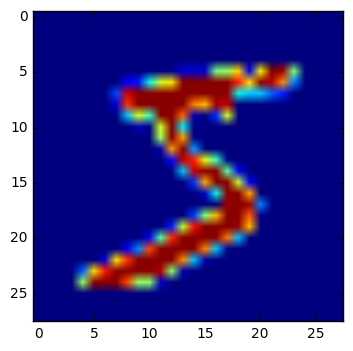

In [229]:
plt.show()

In [235]:
def get_data():
    (x_train, t_train), (x_test, t_test) = \
    load_mnist(normalize=True, flatten=True, one_hot_label=False)
    return x_test, t_test

In [240]:
def init_network():
    with open("sample_weight.pkl", 'rb') as f:
        network = pickle.load(f)
        return network

In [233]:
def predict(network, x):
    W1, W2, W3 = network['W1'], network['W2'], network['W3']
    b1, b2, b3 = network['b1'], network['b2'], network['b3']
    a1 = np.dot(x, W1) + b1
    z1 = sigmoid(a1)
    a2 = np.dot(z1, W2) + b2
    z2 = sigmoid(a2)
    a3 = np.dot(z2, W3) + b3
    y = softmax(a3)
    return y

In [241]:
x,t = get_data()
network = init_network()

NameError: name 'pickle' is not defined

In [237]:
sys.path


['',
 '/home/kei/.pyenv/versions/3.5.2/lib/python35.zip',
 '/home/kei/.pyenv/versions/3.5.2/lib/python3.5',
 '/home/kei/.pyenv/versions/3.5.2/lib/python3.5/plat-linux',
 '/home/kei/.pyenv/versions/3.5.2/lib/python3.5/lib-dynload',
 '/home/kei/.pyenv/versions/3.5.2/lib/python3.5/site-packages',
 '/home/kei/.pyenv/versions/3.5.2/lib/python3.5/site-packages/IPython/extensions',
 '/home/kei/.ipython',
 '..',
 '/home/kei/project/python_lessons/deep-learning-from-scratch-master']

In [242]:
import pickle

In [243]:
x,t = get_data()
network = init_network()

In [244]:
accuracy_cnt = 0

In [245]:
for i in range(len(x)):
    y = predict(network, x[i])
    p = np.argmax(y)
    if p == t[i]:
        accuracy_cnt += 1

In [246]:
print("Accuracy: " + str(float(accuracy_cnt) / len(x)))

Accuracy: 0.9352


In [247]:
network

{'W1': array([[-0.00741249, -0.00790439, -0.01307499, ...,  0.01978721,
         -0.04331266, -0.01350104],
        [-0.01029745, -0.01616653, -0.01228376, ...,  0.01920228,
          0.02809811,  0.01450908],
        [-0.01309184, -0.00244747, -0.0177224 , ...,  0.00944778,
          0.01387301,  0.03393568],
        ..., 
        [ 0.02242565, -0.0296145 , -0.06326169, ..., -0.01012643,
          0.01120969,  0.01027199],
        [-0.00761533,  0.02028973, -0.01498873, ...,  0.02735376,
         -0.01229855,  0.02407041],
        [ 0.00027915, -0.06848375,  0.00911191, ..., -0.03183098,
          0.00743086, -0.04021148]], dtype=float32),
 'W2': array([[-0.10694039,  0.01591247, -0.44349867, ...,  0.03561032,
          0.14045963,  0.03964241],
        [ 0.29911557, -0.03322235, -0.08902215, ..., -0.04722451,
         -0.0972147 ,  0.2950258 ],
        [ 0.06576645,  0.63304549,  0.02325344, ...,  0.05046809,
          0.26831996, -0.13252524],
        ..., 
        [-0.18394209, -0.

In [248]:
x

array([[ 0.,  0.,  0., ...,  0.,  0.,  0.],
       [ 0.,  0.,  0., ...,  0.,  0.,  0.],
       [ 0.,  0.,  0., ...,  0.,  0.,  0.],
       ..., 
       [ 0.,  0.,  0., ...,  0.,  0.,  0.],
       [ 0.,  0.,  0., ...,  0.,  0.,  0.],
       [ 0.,  0.,  0., ...,  0.,  0.,  0.]], dtype=float32)

In [249]:
x.shape

(10000, 784)

In [250]:
len(x)

10000

In [251]:
t

array([7, 2, 1, ..., 4, 5, 6], dtype=uint8)

In [252]:
y

array([  4.28829109e-04,   2.00430372e-06,   2.54056742e-03,
         2.01689386e-06,   5.59177541e-04,   3.12620745e-04,
         9.96147633e-01,   4.34994121e-07,   6.37569337e-06,
         3.77514482e-07], dtype=float32)

In [253]:
x ,t = get_data()

In [254]:
network = init_network()

In [255]:
batch_size = 100

In [256]:
accuracy_cnt = 0

In [257]:
for i in range(0, len(x), batch_size):
    x_batch = x[i:i+batch_size]
    y_batch = predict(network, x_batch)
    p = np.argmax(y_batch, axis=1)
    accuracy_cnt += np.sum(p==t[i:i+batch_size])

In [258]:
print("Accuracy:" + str(float(accuracy_cnt) / len(x)))



Accuracy:0.9352


In [260]:
g = np.array([[0.1,0.8,0.1],[0.3,0.1,0.6],[0.2,0.5,0.3],[0.8,0.1,0.1]])

In [264]:
np.argmax(g, axis=0)

array([3, 0, 1])

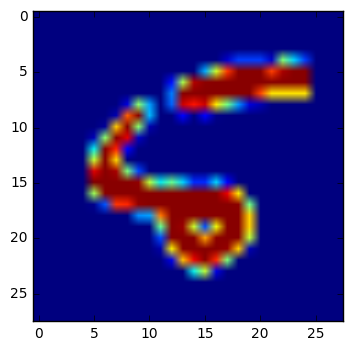

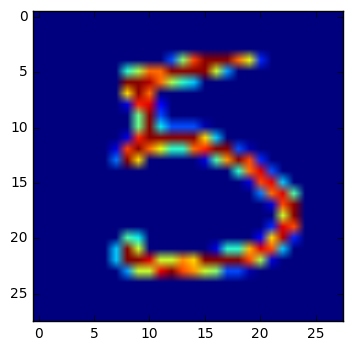

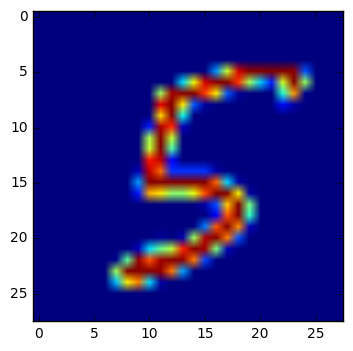

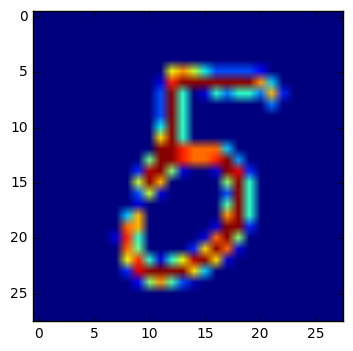

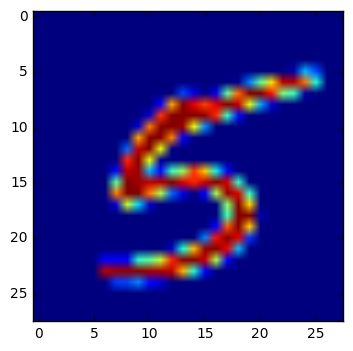

...

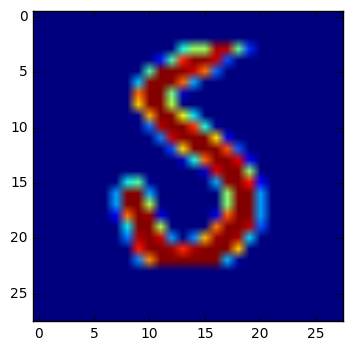

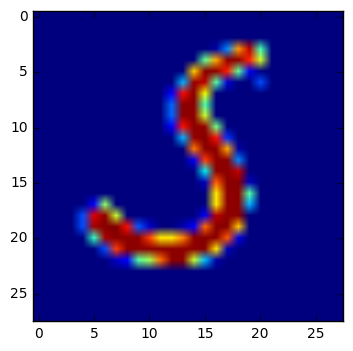

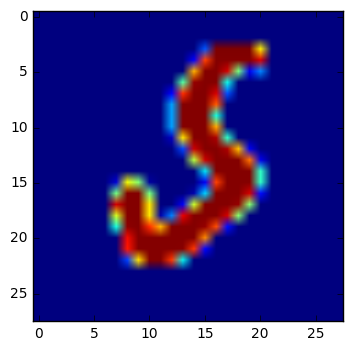

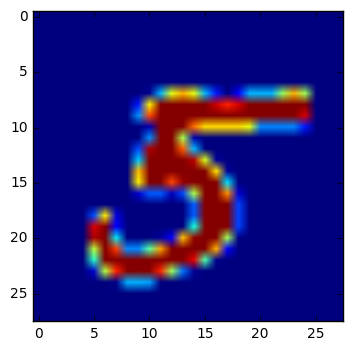

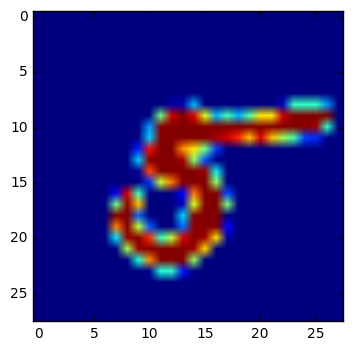

In [265]:
for i in range(len(x_test)):
    img = x_test[i]
    label = t_test[i]
    if(label==5):
        img = img.reshape(28,28)
        plt.imshow(img)
        plt.show()

In [266]:
import sys,os
sys.path.append('/home/kei/project/python_lessons/deep-learning-from-scratch-master')
import numpy as np
from dataset.mnist import load_mnist

In [267]:
(x_train, t_train), (x_test, t_test) = \
load_mnist(normalize=True, one_hot_label=True)


In [269]:
print(x_train.shape)
print(t_train.shape)

(60000, 784)
(60000, 10)


In [270]:
train_size = x_train.shape[0]
batch_size = 10
batch_mask = np.random.choice(train_size, batch_size)
print(batch_mask)

[ 4335 45423 45605 49716 58512 27721 23712 19868  5813 24721]


In [271]:
train_size

60000

In [272]:
batch_size

10

In [273]:
x_batch = x_train[batch_mask]
print(x_batch)

[[ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 ..., 
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]
 [ 0.  0.  0. ...,  0.  0.  0.]]


In [274]:
x_batch.shape

(10, 784)

In [275]:
t_batch = t_train[batch_mask]

In [276]:
x_test.ndim

2

In [277]:
x_test.shape

(10000, 784)

In [278]:
t_test.size

100000

In [279]:
t_test.reshape(1, t_test.size)

array([[ 0.,  0.,  0., ...,  0.,  0.,  0.]])

In [282]:
s1 = np.array([0.1,0.5,0.2,0.2])
s2 = np.array([0,0,1,0])

In [283]:
s1 = s1.reshape(1, s1.size)

In [284]:
s1

array([[ 0.1,  0.5,  0.2,  0.2]])

In [285]:
s2 = s2.reshape(1, s2.size)

In [286]:
s2

array([[0, 0, 1, 0]])

In [287]:
s2.shape

(1, 4)

In [288]:
s2.shape[0]

1

In [289]:
def function_1(x):
    return 0.01 * x ** 2 + 0.1 * x

In [291]:
function_1(5)

0.75

In [292]:
import numpy as np
import matplotlib.pylab as plt

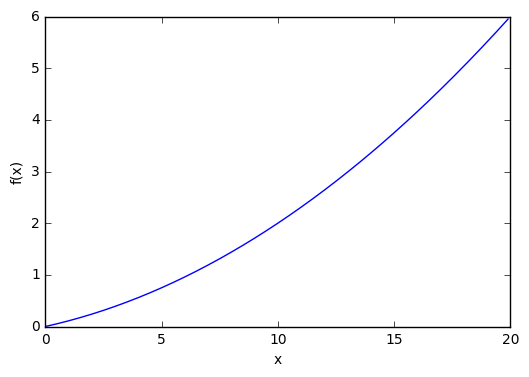

In [294]:
x = np.arange(0.0, 20.0, 0.1)
y = function_1(x)
plt.xlabel("x")
plt.ylabel("f(x)")
plt.plot(x,y)
plt.show()

In [298]:
def numerical_diff(f,x):
    h = 10e-4
    return (f(x+h)-f(x-h)) / (2*h)

In [300]:
numerical_diff(function_1, 10)

0.29999999999996696

In [301]:
def function_2(x):
    return x[0]**2 + x[1]**2

/home/kei/.pyenv/versions/3.5.2/lib/python3.5/site-packages/matplotlib/axes/_axes.py:531: UserWarning: No labelled objects found. Use label='...' kwarg on individual plots.
  warnings.warn("No labelled objects found. "


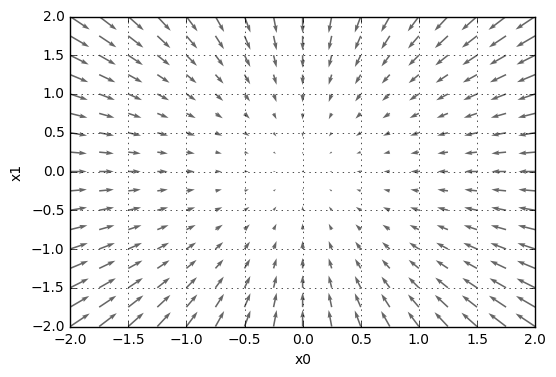

In [302]:
import numpy as np
import matplotlib.pylab as plt
from mpl_toolkits.mplot3d import Axes3D


def _numerical_gradient_no_batch(f, x):
    h = 1e-4 # 0.0001
    grad = np.zeros_like(x)

    for idx in range(x.size):
        tmp_val = x[idx]
        x[idx] = float(tmp_val) + h
        fxh1 = f(x) # f(x+h)

        x[idx] = tmp_val - h
        fxh2 = f(x) # f(x-h)
        grad[idx] = (fxh1 - fxh2) / (2*h)

        x[idx] = tmp_val # 値を元に戻す

    return grad


def numerical_gradient(f, X):
    if X.ndim == 1:
        return _numerical_gradient_no_batch(f, X)
    else:
        grad = np.zeros_like(X)

        for idx, x in enumerate(X):
            grad[idx] = _numerical_gradient_no_batch(f, x)

        return grad


def function_2(x):
    if x.ndim == 1:
        return np.sum(x**2)
    else:
        return np.sum(x**2, axis=1)


def tangent_line(f, x):
    d = numerical_gradient(f, x)
    print(d)
    y = f(x) - d*x
    return lambda t: d*t + y

if __name__ == '__main__':
    x0 = np.arange(-2, 2.5, 0.25)
    x1 = np.arange(-2, 2.5, 0.25)
    X, Y = np.meshgrid(x0, x1)

    X = X.flatten()
    Y = Y.flatten()

    grad = numerical_gradient(function_2, np.array([X, Y]) )

    plt.figure()
    plt.quiver(X, Y, -grad[0], -grad[1],  angles="xy",color="#666666")#,headwidth=10,scale=40,color="#444444")
    plt.xlim([-2, 2])
    plt.ylim([-2, 2])
    plt.xlabel('x0')
    plt.ylabel('x1')
    plt.grid()
    plt.legend()
    plt.draw()
    plt.show()

In [303]:
from mpl_toolkits.mplot3d import Axes3D
import matplotlib.pyplot as plt
import numpy as np

In [304]:
x1 = np.arange(-3,3,0.1)
x2 = np.arange(-3,3,0.1)
x1

array([ -3.00000000e+00,  -2.90000000e+00,  -2.80000000e+00,
        -2.70000000e+00,  -2.60000000e+00,  -2.50000000e+00,
        -2.40000000e+00,  -2.30000000e+00,  -2.20000000e+00,
        -2.10000000e+00,  -2.00000000e+00,  -1.90000000e+00,
        -1.80000000e+00,  -1.70000000e+00,  -1.60000000e+00,
        -1.50000000e+00,  -1.40000000e+00,  -1.30000000e+00,
        -1.20000000e+00,  -1.10000000e+00,  -1.00000000e+00,
        -9.00000000e-01,  -8.00000000e-01,  -7.00000000e-01,
        -6.00000000e-01,  -5.00000000e-01,  -4.00000000e-01,
        -3.00000000e-01,  -2.00000000e-01,  -1.00000000e-01,
         2.66453526e-15,   1.00000000e-01,   2.00000000e-01,
         3.00000000e-01,   4.00000000e-01,   5.00000000e-01,
         6.00000000e-01,   7.00000000e-01,   8.00000000e-01,
         9.00000000e-01,   1.00000000e+00,   1.10000000e+00,
         1.20000000e+00,   1.30000000e+00,   1.40000000e+00,
         1.50000000e+00,   1.60000000e+00,   1.70000000e+00,
         1.80000000e+00,

In [305]:
x2


array([ -3.00000000e+00,  -2.90000000e+00,  -2.80000000e+00,
        -2.70000000e+00,  -2.60000000e+00,  -2.50000000e+00,
        -2.40000000e+00,  -2.30000000e+00,  -2.20000000e+00,
        -2.10000000e+00,  -2.00000000e+00,  -1.90000000e+00,
        -1.80000000e+00,  -1.70000000e+00,  -1.60000000e+00,
        -1.50000000e+00,  -1.40000000e+00,  -1.30000000e+00,
        -1.20000000e+00,  -1.10000000e+00,  -1.00000000e+00,
        -9.00000000e-01,  -8.00000000e-01,  -7.00000000e-01,
        -6.00000000e-01,  -5.00000000e-01,  -4.00000000e-01,
        -3.00000000e-01,  -2.00000000e-01,  -1.00000000e-01,
         2.66453526e-15,   1.00000000e-01,   2.00000000e-01,
         3.00000000e-01,   4.00000000e-01,   5.00000000e-01,
         6.00000000e-01,   7.00000000e-01,   8.00000000e-01,
         9.00000000e-01,   1.00000000e+00,   1.10000000e+00,
         1.20000000e+00,   1.30000000e+00,   1.40000000e+00,
         1.50000000e+00,   1.60000000e+00,   1.70000000e+00,
         1.80000000e+00,

In [306]:
X1, X2 = np.meshgrid(x1, x2)

In [307]:
X1

array([[-3. , -2.9, -2.8, ...,  2.7,  2.8,  2.9],
       [-3. , -2.9, -2.8, ...,  2.7,  2.8,  2.9],
       [-3. , -2.9, -2.8, ...,  2.7,  2.8,  2.9],
       ..., 
       [-3. , -2.9, -2.8, ...,  2.7,  2.8,  2.9],
       [-3. , -2.9, -2.8, ...,  2.7,  2.8,  2.9],
       [-3. , -2.9, -2.8, ...,  2.7,  2.8,  2.9]])

In [308]:
X2

array([[-3. , -3. , -3. , ..., -3. , -3. , -3. ],
       [-2.9, -2.9, -2.9, ..., -2.9, -2.9, -2.9],
       [-2.8, -2.8, -2.8, ..., -2.8, -2.8, -2.8],
       ..., 
       [ 2.7,  2.7,  2.7, ...,  2.7,  2.7,  2.7],
       [ 2.8,  2.8,  2.8, ...,  2.8,  2.8,  2.8],
       [ 2.9,  2.9,  2.9, ...,  2.9,  2.9,  2.9]])

In [309]:
Y = X1**2 + X2**2

In [310]:
fig = plt.figure()
ax = Axes3D(fig)
ax.plot_wireframe(X1,X2,Y)

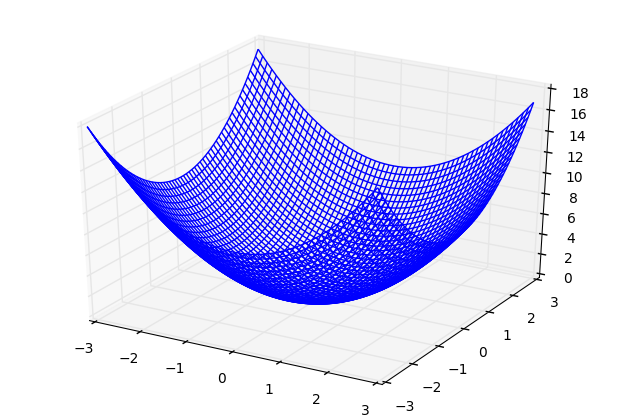

In [311]:
plt.show()

In [312]:
def function_tmp1(x0):
    return x0*x0 + 4.0**2.0


In [314]:
numerical_diff(function_tmp1, 3.0)

5.999999999998451

In [315]:
grad = np.zeros_like(x)

In [316]:
x

array([  0. ,   0.1,   0.2,   0.3,   0.4,   0.5,   0.6,   0.7,   0.8,
         0.9,   1. ,   1.1,   1.2,   1.3,   1.4,   1.5,   1.6,   1.7,
         1.8,   1.9,   2. ,   2.1,   2.2,   2.3,   2.4,   2.5,   2.6,
         2.7,   2.8,   2.9,   3. ,   3.1,   3.2,   3.3,   3.4,   3.5,
         3.6,   3.7,   3.8,   3.9,   4. ,   4.1,   4.2,   4.3,   4.4,
         4.5,   4.6,   4.7,   4.8,   4.9,   5. ,   5.1,   5.2,   5.3,
         5.4,   5.5,   5.6,   5.7,   5.8,   5.9,   6. ,   6.1,   6.2,
         6.3,   6.4,   6.5,   6.6,   6.7,   6.8,   6.9,   7. ,   7.1,
         7.2,   7.3,   7.4,   7.5,   7.6,   7.7,   7.8,   7.9,   8. ,
         8.1,   8.2,   8.3,   8.4,   8.5,   8.6,   8.7,   8.8,   8.9,
         9. ,   9.1,   9.2,   9.3,   9.4,   9.5,   9.6,   9.7,   9.8,
         9.9,  10. ,  10.1,  10.2,  10.3,  10.4,  10.5,  10.6,  10.7,
        10.8,  10.9,  11. ,  11.1,  11.2,  11.3,  11.4,  11.5,  11.6,
        11.7,  11.8,  11.9,  12. ,  12.1,  12.2,  12.3,  12.4,  12.5,
        12.6,  12.7,

In [317]:
10e-4


0.001

In [318]:
grad

array([ 0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,
        0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,
        0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,
        0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,
        0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,
        0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,
        0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,
        0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,
        0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,
        0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,
        0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,
        0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,
        0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,
        0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0

In [319]:
tmp = np.array([2,3])

In [320]:
tmp - 0.1


array([ 1.9,  2.9])

In [321]:
def numerical_gradient(f,x):
    h = 10e-4
    grad = np.zeros_like(x)
    
    for idx in range(x.size):
        tmp_val = x[idx]
        x[idx] = tmp_val + h
        fxh1 = f(x)
        
        x[idx] = tmp_val - h
        fxh2 = f(x)
        
        grad[idx] = (fxh1 - fxh2) / (2*h)
        x[idx] = tmp_val
    
    return grad

In [323]:
numerical_gradient(function_2, np.array([0.0,2.0]))

array([ 0.,  4.])

In [324]:
def gradient_descent(f, init_x, lr=0.01, step_num=100):
    x = init_x
    for i in range(step_num):
        grad = numerical_gradient(f,x)
        x -= lr * grad
    
    return x

In [325]:
init_x = np.array([-3.0, 4.0])

In [334]:
gradient_descent(function_2, init_x=init_x, lr=0.01, step_num=10)

array([ -9.99498878e-20,   7.07272511e-20])

In [335]:
def function_2(x):
    return x[0]**2 + x[1]**2

In [338]:
gradient_descent(function_2, init_x=init_x, lr=0.1, step_num=1)

array([ -9.99498878e-20,   7.07272511e-20])

In [339]:
numerical_gradient(function_2, np.array([0.0,2.0]))

array([ 0.,  4.])

In [340]:
init_x

array([ -9.99498878e-20,   7.07272511e-20])

In [341]:
numerical_gradient(function_2, np.array([0.0,2.0]))

array([ 0.,  4.])

In [346]:
init_x2 = np.array([-3.0, 4.0])

In [347]:
init_x2

array([-3.,  4.])

In [348]:
gradient_descent(function_2, init_x2, lr=0.1, step_num=100)

array([ -6.11110793e-10,   8.14814391e-10])

In [349]:
init_x2

array([ -6.11110793e-10,   8.14814391e-10])

In [366]:
init_x2 = np.array([-3.0, 4.0])
gradient_descent(function_2, init_x2, lr=10, step_num=100)

array([  6.72054824e+14,   2.55483171e+13])

In [367]:
sys.path

['',
 '/home/kei/.pyenv/versions/3.5.2/lib/python35.zip',
 '/home/kei/.pyenv/versions/3.5.2/lib/python3.5',
 '/home/kei/.pyenv/versions/3.5.2/lib/python3.5/plat-linux',
 '/home/kei/.pyenv/versions/3.5.2/lib/python3.5/lib-dynload',
 '/home/kei/.pyenv/versions/3.5.2/lib/python3.5/site-packages',
 '/home/kei/.pyenv/versions/3.5.2/lib/python3.5/site-packages/IPython/extensions',
 '/home/kei/.ipython',
 '..',
 '/home/kei/project/python_lessons/deep-learning-from-scratch-master',
 '/home/kei/project/python_lessons/deep-learning-from-scratch-master']

In [371]:
import sys, os
sys.path.append('/home/kei/project/python_lessons/deep-learning-from-scratch-master')
import numpy as np
from common.functions import softmax, cross_entropy_error
from common.gradient import numerical_gradient

In [372]:
class simpleNet:
    def __init__(self):
        self.W = np.random.randn(2,3)
    
    def predict(self, x):
        return np.dot(x, self.W)
    
    def loss(self, x, t):
        z = self.predict(x)
        y = softmax(z)
        loss = cross_entropy_error(y, t)
        
        return loss
    

In [373]:
np.random.randn(2,3)

array([[-1.96719241, -1.24685561, -0.93708953],
       [-0.0563947 ,  1.89943141, -0.34850846]])

In [374]:
np.random.randn(2,3)

array([[ 0.69477783, -0.57306479,  0.29974966],
       [ 1.21994239, -0.04653904, -0.03190727]])

In [375]:
net = simpleNet()

In [376]:
print(net.W)

[[-0.38830723 -0.77613599 -0.5263748 ]
 [ 0.24469747 -0.35054857 -1.97094302]]


In [377]:
x = np.array([0.6,0.9])

In [378]:
p = net.predict(x)

In [379]:
p

array([-0.01275661, -0.7811753 , -2.0896736 ])

In [380]:
np.argmax(p)

0

In [381]:
t = np.array([1,0,0])

In [382]:
net.loss(x,t)

0.4631437677189621

In [383]:
def f(W):
    return net.loss(x,t)

In [384]:
dW = numerical_gradient(f, net.W)

In [385]:
print(dW)

[[-0.22241871  0.17510174  0.04731696]
 [-0.33362806  0.26265262  0.07097545]]


In [386]:
net.W

array([[-0.38830723, -0.77613599, -0.5263748 ],
       [ 0.24469747, -0.35054857, -1.97094302]])

In [387]:
f(W)

NameError: name 'W' is not defined

In [388]:
f(net.W)

0.4631437677189621

In [389]:
net.loss(x,t)

0.4631437677189621

In [390]:
x

array([ 0.6,  0.9])

In [393]:
def f(W):
    return net.loss(x,t)

In [394]:
f(net.W)

0.4631437677189621

In [395]:
f(x)

0.4631437677189621

In [396]:
net.predict(x)

array([-0.01275661, -0.7811753 , -2.0896736 ])